In [1]:
import sys
import numpy as np
import numpy as np
import matplotlib.pyplot as plt
import sys
import h5py
from sklearn import metrics
import seaborn as sns
import ncempy.io.dm as dm
import ncempy.io.mrc as mrc
sys.path.append('/Users/cgroschner/Documents/HTTEM/segmentation/')
import realDataProcess as rdp
import segmentationAnalysis as sega
from keras.models import Model
from keras.layers import *
from keras.optimizers import Adam
from keras.utils import to_categorical
from keras import backend as K
from keras.callbacks import EarlyStopping, ModelCheckpoint, TensorBoard
from keras.losses import binary_crossentropy
from keras.models import load_model
import pandas as pd
from matplotlib.patches import Rectangle
import scipy.fftpack as ftp
from scipy.signal import medfilt2d
from scipy import signal
import CNNviz as cviz

/Users/cgroschner/anaconda/lib/python3.6/site-packages/h5py/__init__.py:36: FutureWarning: Conversion of the second argument of issubdtype from `float` to `np.floating` is deprecated. In future, it will be treated as `np.float64 == np.dtype(float).type`.
  from ._conv import register_converters as _register_converters
Using TensorFlow backend.


In [2]:
def bragg_filter(img,ksize = 9, sig = 1,shape = (512,512),cut_edge = (50,50), plot = False):
    fft = ftp.fftshift(ftp.fft2(img.reshape(img.shape[0],img.shape[1])))
    intf = np.log(abs(fft)**2)
    intfilt= medfilt2d(intf,kernel_size=25)
#     intf = signal.convolve2d(intf,kernel)
#     cut_pix_x = (intf.shape[0]- shape[0])//2
#     cut_pix_y = (intf.shape[1]- shape[1])//2
#     intf = intf[cut_pix_x:-cut_pix_x,cut_pix_y:-cut_pix_y]
    if plot == True:
        plt.figure()
        rdp.imm(img)
        plt.figure()
        rdp.imm(intf)
        plt.figure()
        rdp.imm(intfilt)
    dif = intf-intfilt
#     dif = closing(dif)
#     dif = opening(dif)
    dif[dif < 2*intfilt.std()] = 0
    if plot == True:
        plt.figure()
        rdp.imm(dif)
    kernel = gkern(ksize,sig)
    if plot == True:
        plt.figure()
        plt.imshow(kernel)
    peaks = signal.convolve2d(dif,kernel)
    cut_pix_x = (peaks.shape[0]- shape[0])//2
    cut_pix_y = (peaks.shape[1]- shape[1])//2
    peaks = peaks[cut_pix_x:-cut_pix_x,cut_pix_y:-cut_pix_y]
    if plot == True:
        plt.figure()
        rdp.imm(dif)
    peaks[:cut_edge[0],:]= 0
    peaks[-cut_edge[0]:,:] =0
    peaks[:,:cut_edge[1]]= 0
    peaks[:,-cut_edge[1]:] =0
    peaks[peaks>0] = 1
    smoother_peaks = signal.convolve2d(peaks,kernel)
    smoother_peaks = smoother_peaks[cut_pix_x:-cut_pix_x,cut_pix_y:-cut_pix_y]
    inv_peaks = smoother_peaks.copy()
    inv_peaks += 1
    inv_peaks[inv_peaks> 1] = 0
    inv_peaks = signal.convolve2d(inv_peaks,kernel)
    inv_peaks = inv_peaks[cut_pix_x:-cut_pix_x,cut_pix_y:-cut_pix_y]
    filtered_fft = fft*smoother_peaks
    inv_filtered_fft = fft*inv_peaks
    return filtered_fft, inv_filtered_fft

In [3]:
def gkern(kernlen=21, std=3):
    """Returns a 2D Gaussian kernel array."""
    gkern1d = signal.gaussian(kernlen, std=std).reshape(kernlen, 1)
    gkern2d = np.outer(gkern1d, gkern1d)
    return gkern2d

In [4]:
def SNR(img,ksize= 9, sig =1,shape = (512,512),cut_edge = (50,50), plot = False):
    filtered_fft,inv_filtered_fft = bragg_filter(img,ksize,sig,shape,cut_edge,plot)
    if plot == True:
        plt.figure()
        display(plt.imshow(np.log(abs(filtered_fft)**2)))
        plt.figure()
        plt.imshow(np.log(abs(inv_filtered_fft)**2))
    bragg = abs(filtered_fft.flatten())**2
    background = abs(inv_filtered_fft.flatten())**2
    snr = np.sum(bragg)/np.sum(background)
    return snr

In [4]:
Au = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/Au/Bal_MedFilt_cutimages_20190726.h5')['images'][:,:,:,:]
CdSe = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/relabel_CdSedots/Bal_MedFilt_CdSeRelabel512Images_20190726.h5')['images'][:,:,:,:]
FePt = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/FePt/08_FePt_FocalSeries_20190726.h5')['images'][:,:,:,:]

In [322]:
AuMaps = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/Au/Bal_unFilt_cutimages_20190423_maps.h5')['maps'][:,:,:,:]
CdSeMaps = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/relabel_CdSedots/Bal_unFilt_CdSeRelabel512Images_20190724_maps.h5')['maps'][:,:,:,:]
FePtMaps = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/FePt/08_FePt_FocalSeries_20190726_maps.h5')['maps'][:,:,:,:]

In [55]:
FePt = rdp.median_filter_stack(FePt)

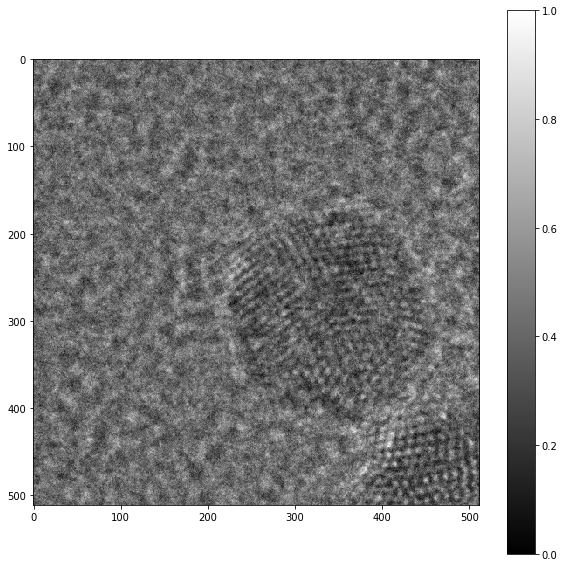

In [10]:
rdp.imm(Au[2])

In [19]:
SNR(Au[2])

193.85645116071268

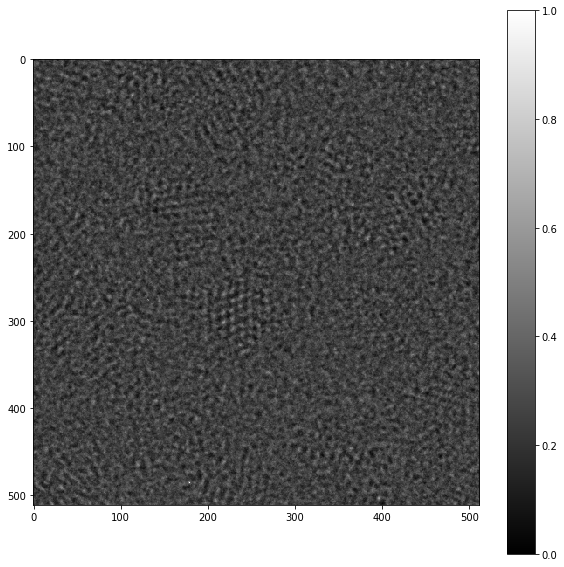

In [22]:
rdp.imm(CdSe[2])

In [23]:
SNR(CdSe[2])

17.65413402351575

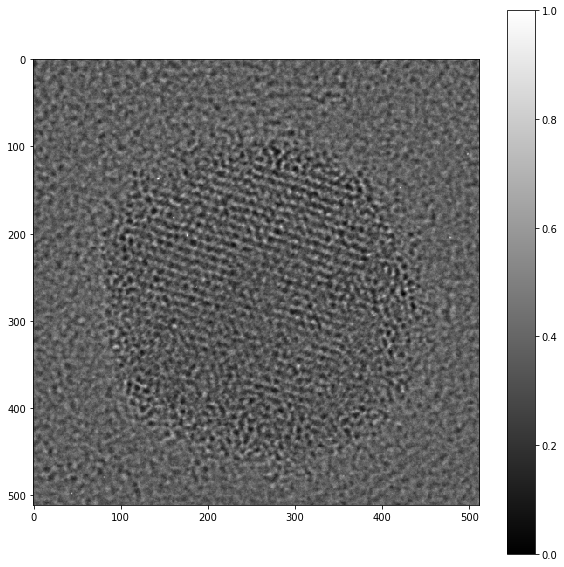

In [68]:
rdp.imm(FePt[105])

In [32]:
SNR(FePt[0])

84.83545495098002

In [69]:
SNR(FePt[105])

26.984666921150254

In [34]:
def  dice_coef(y_true, y_pred, smooth=1):
    y_true_f = K.flatten(y_true)
    y_pred_f = K.flatten(y_pred)

    intersection = K.sum(y_true_f * y_pred_f)
    return (2. * intersection + smooth) / (K.sum(y_true_f) + K.sum(y_pred_f) + smooth)

def dice_coef_loss(y_true, y_pred):
    return 1-dice_coef(y_true, y_pred)

def bce_dice_loss(y_true, y_pred):
    return binary_crossentropy(y_true, y_pred) + dice_coef_loss(y_true, y_pred)

def down(filters, input_):
    down_ = Conv2D(filters, (3, 3), padding='same')(input_)
    down_ = BatchNormalization(epsilon=1e-4)(down_)
    down_res = Activation('relu')(down_)
    down_pool = MaxPooling2D((2, 2), strides=(2, 2))(down_)
    return down_pool, down_res

def up(filters, input_, down_):
    up_ = UpSampling2D((2, 2))(input_)
    up_ = concatenate([down_, up_], axis=3)
    up_ = Conv2D(filters, (3, 3), padding='same')(up_)
    up_ = BatchNormalization(epsilon=1e-4)(up_)
    up_ = Activation('relu')(up_)
    up_ = Dropout(0.2)(up_)
    up_ = Conv2D(filters, (3, 3), padding='same')(up_)
    up_ = BatchNormalization(epsilon=1e-4)(up_)
    up_ = Activation('relu')(up_)
    return up_

def get_unet_1024(input_shape, num_classes=1):
    inputs = Input(shape=input_shape)

    #down0b, down0b_res = down(8, inputs)
    down0a, down0a_res = down(4, inputs)
    down0, down0_res = down(8, down0a)
    down1, down1_res = down(16, down0)
    down2, down2_res = down(32, down1)

    center = Conv2D(32, (3, 3), padding='same')(down2)
    center = BatchNormalization(epsilon=1e-4)(center)
    center = Activation('relu')(center)
    center = Conv2D(32, (3, 3), padding='same')(center)
    center = BatchNormalization(epsilon=1e-4)(center)
    center = Activation('relu')(center)

    up2 = up(32, center, down2_res)
    up1 = up(16, up2, down1_res)
    up0 = up(8, up1, down0_res)
    up0a = up(4, up0, down0a_res)
    #up0b = up(8, up0a, down0b_res)

    classify = Conv2D(num_classes, (1, 1), activation='sigmoid', name='final_layer')(up0a)

    model = Model(inputs=inputs, outputs=classify)

    return model

In [35]:
model04 = get_unet_1024((512,512,1),2)

In [36]:
model04.load_weights('/Users/cgroschner/Documents/HTTEM/segmentation/trained_models/unet32_AuCdSeDots_04.h5')

In [37]:
Au_pred = model04.predict(Au[2:3])

In [57]:
FePt_pred = model04.predict(FePt[0:1])

In [70]:
FePt_pred2 = model04.predict(FePt[105:106])

In [40]:
CdSe_pred = model04.predict(CdSe[2:3])

In [41]:
thresh = 0.64

In [42]:
binAu = sega.binarize_map(Au_pred[:,:,:,1],thresh)

In [43]:
binCdSe = sega.binarize_map(CdSe_pred[:,:,:,1],thresh)

In [58]:
binFePt = sega.binarize_map(FePt_pred[:,:,:,1],thresh)

In [71]:
binFePt2 = sega.binarize_map(FePt_pred2[:,:,:,1],thresh)

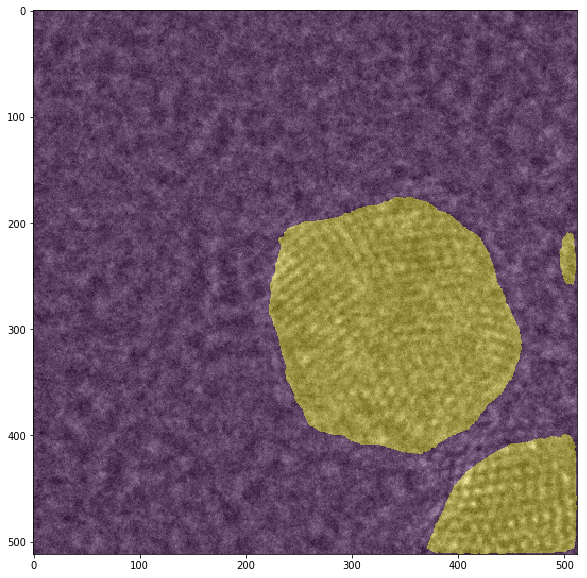

In [46]:
rdp.immOverlay(Au[2:3],binAu,0)

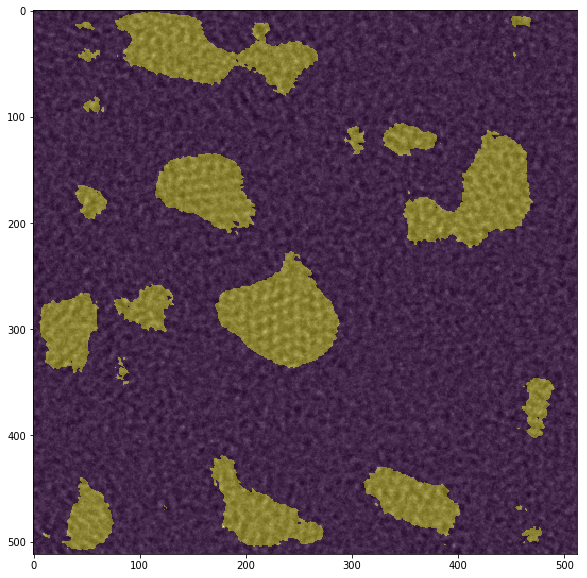

In [47]:
rdp.immOverlay(CdSe[2:3],binCdSe,0)

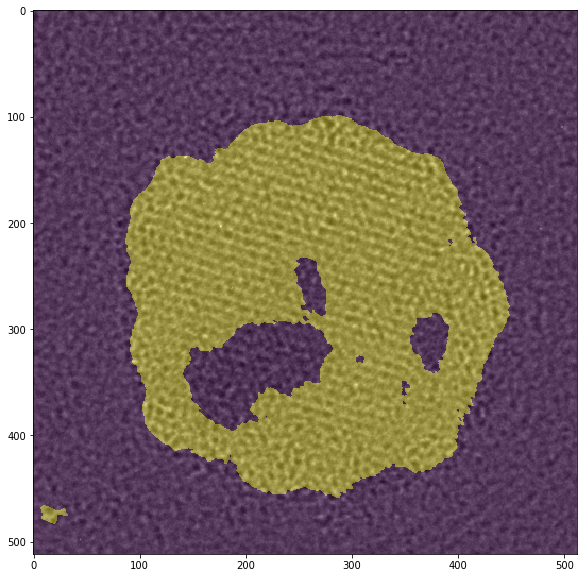

In [72]:
rdp.immOverlay(FePt[105:106],binFePt2,0)

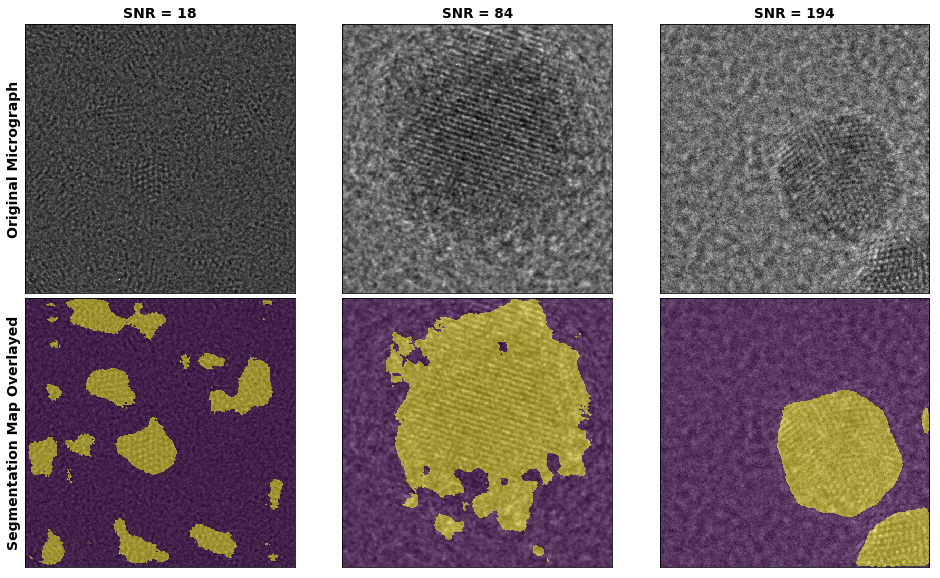

In [73]:
fig, axs = plt.subplots(nrows=2, ncols=3, figsize=(17, 10),
                        subplot_kw={'xticks': [], 'yticks': []},sharex=True,sharey=True)
fig.subplots_adjust(hspace=0.015, wspace=0.01)
axs[0,0].imshow(CdSe[2].reshape((512,512)),cmap='gray')
axs[0,1].imshow(FePt[0].reshape((512,512)),cmap='gray')
axs[0,2].imshow(Au[2].reshape((512,512)),cmap='gray')
axs[1,0].imshow(CdSe[2].reshape((512,512)),cmap='gray')
axs[1,0].imshow(binCdSe[0].reshape((512,512)),alpha=0.5)
axs[1,1].imshow(FePt[0].reshape((512,512)),cmap='gray')
axs[1,1].imshow(binFePt[0].reshape((512,512)),alpha=0.5)
axs[1,2].imshow(Au[2].reshape((512,512)),cmap='gray')
axs[1,2].imshow(binAu[0].reshape((512,512)),alpha = 0.5)

axs[0,0].set_title('SNR = 18',fontsize = 14,fontweight = 'semibold')
axs[0,1].set_title('SNR = 84',fontsize = 13.5,fontweight = 'semibold')
axs[0,2].set_title('SNR = 194',fontsize = 13.5,fontweight = 'semibold')
rows = ['Original Micrograph','Segmentation Map Overlayed']
for ax, row in zip(axs[:,0], rows):
    ax.set_ylabel(row, rotation=90, fontsize = 14,fontweight = 'semibold')
plt.savefig('/Users/cgroschner/Desktop/ML_paper_figures/PaperV2/SNRimg.png')

In [268]:
FePt_bragg = np.load('/Users/cgroschner/Documents/HTTEM/segmentation/data_postprocessing/FePt_bragg.npy')

In [249]:
Au_bragg = np.load('/Users/cgroschner/Documents/HTTEM/segmentation/data_postprocessing/Au_bragg.npy')

In [251]:
CdSe_bragg = np.load('/Users/cgroschner/Documents/HTTEM/segmentation/data_postprocessing/CdSe_bragg.npy')

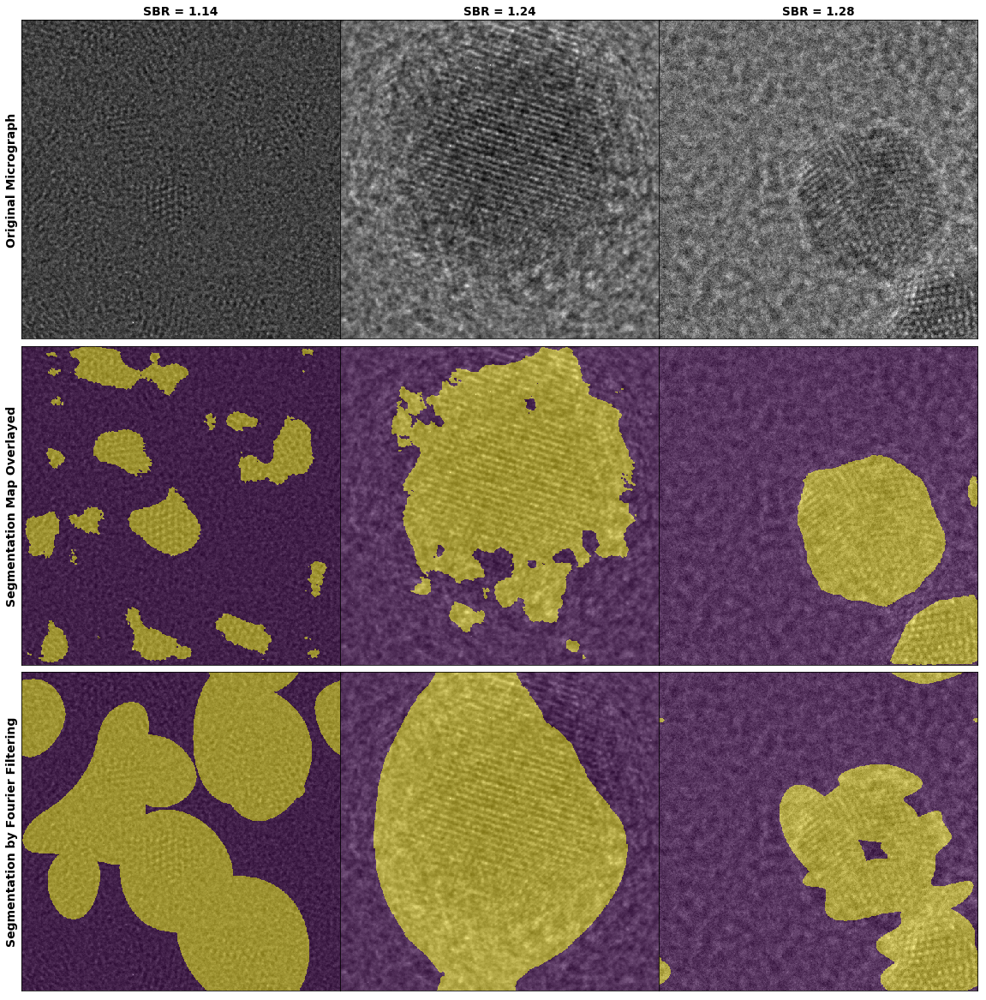

In [467]:
fig, axs = plt.subplots(nrows=3, ncols=3, figsize=(20, 21),
                        subplot_kw={'xticks': [], 'yticks': []},sharex=True,sharey=True)
fig.subplots_adjust(hspace=0.00001, wspace=0.0)
axs[0,0].imshow(CdSe[2].reshape((512,512)),cmap='gray')
axs[0,1].imshow(FePt[0].reshape((512,512)),cmap='gray')
axs[0,2].imshow(Au[2].reshape((512,512)),cmap='gray')
axs[1,0].imshow(CdSe[2].reshape((512,512)),cmap='gray')
axs[1,0].imshow(binCdSe[0].reshape((512,512)),alpha=0.5)
axs[1,1].imshow(FePt[0].reshape((512,512)),cmap='gray')
axs[1,1].imshow(binFePt[0].reshape((512,512)),alpha=0.5)
axs[1,2].imshow(Au[2].reshape((512,512)),cmap='gray')
axs[1,2].imshow(binAu[0].reshape((512,512)),alpha = 0.5)
axs[2,0].imshow(CdSe[2].reshape((512,512)),cmap='gray')
axs[2,0].imshow(CdSe_bragg[0].reshape((512,512)),alpha=0.5)
axs[2,1].imshow(FePt[0].reshape((512,512)),cmap='gray')
axs[2,1].imshow(FePt_bragg[0].reshape((512,512)),alpha=0.5)
axs[2,2].imshow(Au[2].reshape((512,512)),cmap='gray')
axs[2,2].imshow(Au_bragg[0].reshape((512,512)),alpha = 0.5)

axs[0,0].set_title('SBR = 1.16',fontsize = 14,fontweight = 'semibold')
axs[0,1].set_title('SBR = 1.24',fontsize = 13.5,fontweight = 'semibold')
axs[0,2].set_title('SBR = 1.49',fontsize = 13.5,fontweight = 'semibold')
rows = ['Original Micrograph','Segmentation Map Overlayed','Segmentation by Fourier Filtering']
for ax, row in zip(axs[:,0], rows):
    ax.set_ylabel(row, rotation=90, fontsize = 14,fontweight = 'semibold')
plt.savefig('/Users/cgroschner/Desktop/ML_paper_figures/PaperV2/SNRimg2.png')

In [479]:
FePt_bragg[0].max()

1.0

In [480]:
metrics.accuracy_score(FePtMaps[0,:,:,1].flatten(),FePt_bragg[0].flatten())

0.7395477294921875

In [481]:
metrics.accuracy_score(CdSeMaps[2,:,:,1].flatten(),CdSe_bragg[0].flatten())

0.5091361999511719

In [482]:
metrics.accuracy_score(AuMaps[2,:,:,1].flatten(),Au_bragg[0].flatten())

0.9203987121582031

In [487]:
metrics.accuracy_score(AuMaps[2,:,:,1].flatten(),binAu[0].flatten())

0.969146728515625

In [488]:
metrics.accuracy_score(CdSeMaps[2,:,:,1].flatten(),binCdSe[0].flatten())

0.8258171081542969

In [489]:
metrics.accuracy_score(FePtMaps[0,:,:,1].flatten(),binFePt[0].flatten())

0.8773994445800781

In [74]:
def SNR_stack(stack,ksize= 9, sig =1,shape = (512,512),cut_edge = (50,50),plot = False):
    snrs = []
    count = 0
    for img in stack:
        snrs.append(SNR(img,ksize,sig,shape,cut_edge,plot))
        count += 1
        if count%10 == 0:
            print('{}/{} images done'.format(count,len(stack)))
    snrs = np.array(snrs)
    print('Average SNR is {:8.2f}'.format(snrs.mean()))
    print('Median SNR is {:8.2f}'.format(np.median(snrs)))
    return snrs

In [370]:
def SBR(img,seg_map):
    """Calculates foreground to background ratio based on segmentation map. Note map must be 2D grayscale from 0 to 1"""
    img = img/img.max()
    if len(img.shape)==4:
        shape = (img.shape[1],img.shape[2])
    elif len(img.shape)==3:
        shape = (img.shape[0],img.shape[1])
    foreground = img.reshape(shape)*seg_map.reshape(shape)
    inv_map = seg_map.copy()
    inv_map += 1
    inv_map[inv_map>1] = 0
    background = img.reshape(shape)*inv_map.reshape(shape)
    sbr = np.sum(abs(foreground.flatten()))/np.sum(abs(background.flatten()))
    return sbr

In [411]:
def SBR2(img,seg_map):
    """Calculates foreground to background ratio based on segmentation map. Note map must be 2D grayscale from 0 to 1"""
    img = img/img.max()
    if len(img.shape)==4:
        shape = (img.shape[1],img.shape[2])
    elif len(img.shape)==3:
        shape = (img.shape[0],img.shape[1])
    foreground = img.reshape(shape)*seg_map.reshape(shape)
    num_fore = (foreground != 0).sum()
    inv_map = seg_map.copy()
    inv_map += 1
    inv_map[inv_map>1] = 0
    background = img.reshape(shape)*inv_map.reshape(shape)
    num_back = (background != 0).sum()
    sbr = (np.sum(abs(foreground.flatten()))/num_fore)/(np.sum(abs(background.flatten()))/num_back)
    return sbr, (np.sum(abs(foreground.flatten()))/num_fore),(np.sum(abs(background.flatten()))/num_back)

In [435]:
def SBR4(img,seg_map):
    """Calculates foreground to background ratio based on segmentation map. Note map must be 2D grayscale from 0 to 1"""
    img = img/img.max()
    if len(img.shape)==4:
        shape = (img.shape[1],img.shape[2])
    elif len(img.shape)==3:
        shape = (img.shape[0],img.shape[1])
    foreground = img.reshape(shape)*seg_map.reshape(shape)
    num_fore = (foreground != 0).sum()
    inv_map = seg_map.copy()
    inv_map += 1
    inv_map[inv_map>1] = 0
    background = img.reshape(shape)*inv_map.reshape(shape)
    num_back = (background != 0).sum()
    sbr = abs(foreground.flatten()).mean()/abs(background.flatten()).std()
    return sbr

In [406]:
np.count_nonzero(AuMaps[0])

262144

In [407]:
(AuMaps[0]!=0).sum()

262144

In [333]:
def SBR_stack(stack, seg_maps):
    sbrs = []
    count = 0
    for idx,img in enumerate(stack):
        sbrs.append(SBR(img, seg_maps[idx]))
        count += 1
        if count%10 == 0:
            print('{}/{} images done'.format(count,len(stack)))
    sbrs = np.array(sbrs)
    print('Average SBR is {:8.2f}'.format(sbrs.mean()))
    print('Median SBR is {:8.2f}'.format(np.median(sbrs)))
    return sbrs

In [368]:
def SBR_stack_center(stack, seg_maps):
    sbrs = []
    count = 0
    for idx,img in enumerate(stack):
        avg = img.mean()
        img = img - avg
        sbrs.append(SBR(img, seg_maps[idx]))
        count += 1
        if count%10 == 0:
            print('{}/{} images done'.format(count,len(stack)))
    sbrs = np.array(sbrs)
    print('Average SBR is {:8.2f}'.format(sbrs.mean()))
    print('Median SBR is {:8.2f}'.format(np.median(sbrs)))
    return sbrs

In [414]:
def SBR_stack3(stack, seg_maps):
    sbrs = []
    count = 0
    for idx,img in enumerate(stack):
        avg = img.mean()
        img = img - avg
        sbrs.append(SBR2(img, seg_maps[idx]))
        count += 1
        if count%10 == 0:
            print('{}/{} images done'.format(count,len(stack)))
    sbrs = np.array(sbrs)
    print('Average SBR is {:8.2f}'.format(sbrs[:,0].mean()))
    print('Median SBR is {:8.2f}'.format(np.median(sbrs[:,0])))
    return sbrs

In [436]:
def SBR_stack4(stack, seg_maps):
    sbrs = []
    count = 0
    for idx,img in enumerate(stack):
        avg = img.mean()
        img = img - avg
        sbrs.append(SBR4(img, seg_maps[idx]))
        count += 1
        if count%10 == 0:
            print('{}/{} images done'.format(count,len(stack)))
    sbrs = np.array(sbrs)
    print('Average SBR is {:8.2f}'.format(sbrs.mean()))
    print('Median SBR is {:8.2f}'.format(np.median(sbrs)))
    return sbrs

In [306]:
SBR(FePt[0],binFePt[0])

0.6237830824388344

In [308]:
SBR(Au[2],binAu[0])

0.23326648743658682

In [309]:
SBR(CdSe[2],binCdSe[0])

0.20438899696506135

In [312]:
AuMaps.shape

(216, 512, 512, 2)

In [412]:
Au_sbr = SBR_stack(Au,AuMaps[:,:,:,1])

10/216 images done
20/216 images done
30/216 images done
40/216 images done
50/216 images done
60/216 images done
70/216 images done
80/216 images done
90/216 images done
100/216 images done
110/216 images done
120/216 images done
130/216 images done
140/216 images done
150/216 images done
160/216 images done
170/216 images done
180/216 images done
190/216 images done
200/216 images done
210/216 images done
Average SBR is     0.88
Median SBR is     0.47


In [371]:
Au_sbr2 = SBR_stack_center(Au,AuMaps[:,:,:,1])

10/216 images done
20/216 images done
30/216 images done
40/216 images done
50/216 images done
60/216 images done
70/216 images done
80/216 images done
90/216 images done
100/216 images done
110/216 images done
120/216 images done
130/216 images done
140/216 images done
150/216 images done
160/216 images done
170/216 images done
180/216 images done
190/216 images done
200/216 images done
210/216 images done
Average SBR is     1.11
Median SBR is     0.63


In [415]:
Au_sbr3 = SBR_stack3(Au,AuMaps[:,:,:,1])

10/216 images done
20/216 images done
30/216 images done
40/216 images done
50/216 images done
60/216 images done
70/216 images done
80/216 images done
90/216 images done
100/216 images done
110/216 images done
120/216 images done
130/216 images done
140/216 images done
150/216 images done
160/216 images done
170/216 images done
180/216 images done
190/216 images done
200/216 images done
210/216 images done
Average SBR is     1.20
Median SBR is     1.17


In [437]:
Au_sbr4 = SBR_stack4(Au,AuMaps[:,:,:,1])

10/216 images done
20/216 images done
30/216 images done
40/216 images done
50/216 images done
60/216 images done
70/216 images done
80/216 images done
90/216 images done
100/216 images done
110/216 images done
120/216 images done
130/216 images done
140/216 images done
150/216 images done
160/216 images done
170/216 images done
180/216 images done
190/216 images done
200/216 images done
210/216 images done
Average SBR is     0.62
Median SBR is     0.53


In [336]:
CdSe_sbr = SBR_stack(CdSe,CdSeMaps[:,:,:,1])

10/172 images done
20/172 images done
30/172 images done
40/172 images done
50/172 images done
60/172 images done
70/172 images done
80/172 images done
90/172 images done
100/172 images done
110/172 images done
120/172 images done
130/172 images done
140/172 images done
150/172 images done
160/172 images done
170/172 images done
Average SBR is     0.18
Median SBR is     0.15


In [372]:
CdSe_sbr2 = SBR_stack_center(CdSe,CdSeMaps[:,:,:,1])

10/172 images done
20/172 images done
30/172 images done
40/172 images done
50/172 images done
60/172 images done
70/172 images done
80/172 images done
90/172 images done
100/172 images done
110/172 images done
120/172 images done
130/172 images done
140/172 images done
150/172 images done
160/172 images done
170/172 images done
Average SBR is     0.21
Median SBR is     0.17


In [416]:
CdSe_sbr3 = SBR_stack3(CdSe,CdSeMaps[:,:,:,1])

10/172 images done
20/172 images done
30/172 images done
40/172 images done
50/172 images done
60/172 images done
70/172 images done
80/172 images done
90/172 images done
100/172 images done
110/172 images done
120/172 images done
130/172 images done
140/172 images done
150/172 images done
160/172 images done
170/172 images done
Average SBR is     1.15
Median SBR is     1.14


In [438]:
CdSe_sbr4 = SBR_stack4(CdSe,CdSeMaps[:,:,:,1])

10/172 images done
20/172 images done
30/172 images done
40/172 images done
50/172 images done
60/172 images done
70/172 images done
80/172 images done
90/172 images done
100/172 images done
110/172 images done
120/172 images done
130/172 images done
140/172 images done
150/172 images done
160/172 images done
170/172 images done
Average SBR is     0.21
Median SBR is     0.19


In [323]:
FePtMaps.shape

(203, 512, 512, 2)

In [321]:
FePt.shape

(203, 512, 512, 1)

In [335]:
FePt_sbr = SBR_stack(FePt,FePtMaps[:,:,:,1])

10/203 images done
20/203 images done
30/203 images done
40/203 images done
50/203 images done
60/203 images done
70/203 images done
80/203 images done
90/203 images done
100/203 images done
110/203 images done
120/203 images done
130/203 images done
140/203 images done
150/203 images done
160/203 images done
170/203 images done
180/203 images done
190/203 images done
200/203 images done
Average SBR is     0.53
Median SBR is     0.53


In [373]:
FePt_sbr2 = SBR_stack_center(FePt,FePtMaps[:,:,:,1])

10/203 images done
20/203 images done
30/203 images done
40/203 images done
50/203 images done
60/203 images done
70/203 images done
80/203 images done
90/203 images done
100/203 images done
110/203 images done
120/203 images done
130/203 images done
140/203 images done
150/203 images done
160/203 images done
170/203 images done
180/203 images done
190/203 images done
200/203 images done
Average SBR is     0.79
Median SBR is     0.78


In [417]:
FePt_sbr3 = SBR_stack3(FePt,FePtMaps[:,:,:,1])

10/203 images done
20/203 images done
30/203 images done
40/203 images done
50/203 images done
60/203 images done
70/203 images done
80/203 images done
90/203 images done
100/203 images done
110/203 images done
120/203 images done
130/203 images done
140/203 images done
150/203 images done
160/203 images done
170/203 images done
180/203 images done
190/203 images done
200/203 images done
Average SBR is     1.22
Median SBR is     1.21


In [439]:
FePt_sbr4 = SBR_stack4(FePt,FePtMaps[:,:,:,1])

10/203 images done
20/203 images done
30/203 images done
40/203 images done
50/203 images done
60/203 images done
70/203 images done
80/203 images done
90/203 images done
100/203 images done
110/203 images done
120/203 images done
130/203 images done
140/203 images done
150/203 images done
160/203 images done
170/203 images done
180/203 images done
190/203 images done
200/203 images done
Average SBR is     0.61
Median SBR is     0.61


In [338]:
print('CdSe SBR: {:8.2f}, FePt SBR: {:8.2f}, Au SBR: {:8.2f}'.format(CdSe_sbr[2],FePt_sbr[0],Au_sbr[2]))

CdSe SBR:     0.34, FePt SBR:     0.60, Au SBR:     0.26


In [440]:
print('CdSe SBR: {:8.2f}, FePt SBR: {:8.2f}, Au SBR: {:8.2f}'.format(CdSe_sbr4[2],FePt_sbr4[0],Au_sbr4[2]))

CdSe SBR:     0.37, FePt SBR:     0.68, Au SBR:     0.36


In [490]:
print('CdSe SBR: {:8.2f}, FePt SBR: {:8.2f}, Au SBR: {:8.2f}'.format(CdSe_sbr3[134,0],FePt_sbr3[0,0],Au_sbr3[141,0]))

CdSe SBR:     1.16, FePt SBR:     1.24, Au SBR:     1.49


In [75]:
snrs = SNR_stack(FePt)

10/203 images done
20/203 images done
30/203 images done
40/203 images done
50/203 images done
60/203 images done
70/203 images done
80/203 images done
90/203 images done
100/203 images done
110/203 images done
120/203 images done
130/203 images done
140/203 images done
150/203 images done
160/203 images done
170/203 images done
180/203 images done
190/203 images done
200/203 images done
Average SNR is    20.44
Median SNR is    20.29


In [76]:
fept_maps = h5pypy.File('/Users/cgroschner/Documents/HTTEM/particle_data/FePt/08_FePt_FocalSeries_20190726_maps.h5')['maps'][:,:,:,:]

In [77]:
fept_pred = model04.predict(FePt)

In [78]:
fept_bin = sega.binarize_map(fept_pred[:,:,:,1],thresh)

In [80]:
fept_maps.shape

(203, 512, 512, 2)

In [81]:
FePt.shape

(203, 512, 512, 1)

In [84]:
fept_bin = np.expand_dims(fept_bin,axis=3)

In [87]:
fept_bin.shape

(203, 512, 512, 1)

In [88]:
acc_list = []
for idx,m in enumerate(fept_maps[:,:,:,1]):
    acc_list.append(metrics.accuracy_score(m.flatten(),fept_bin[idx].flatten()))

In [340]:
FePt_acc_list = acc_list

In [89]:
len(acc_list)

203

In [90]:
len(snrs)

203

In [ ]:
Au_acc_list = []
for idx,m in enumerate(AuMaps[:,:,:,1]):
    acc_list.append(metrics.accuracy_score(m.flatten(),fept_bin[idx].flatten()))

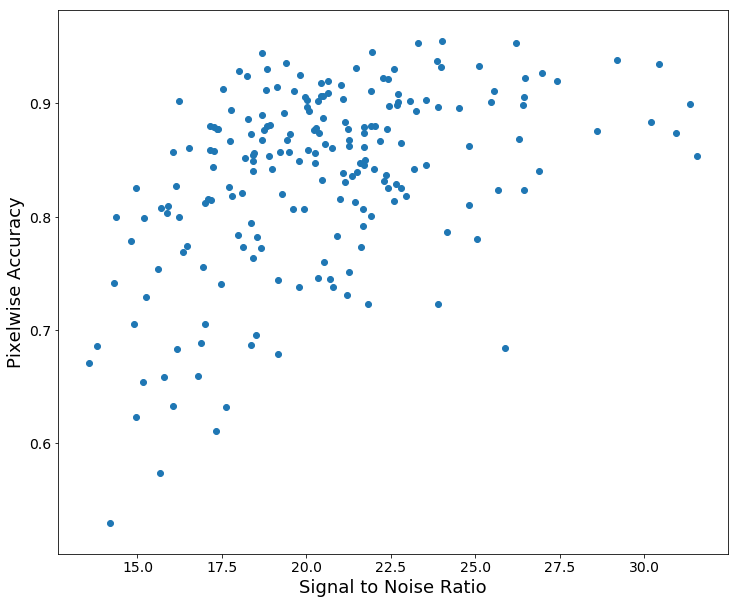

In [243]:
plt.figure(figsize=(12,10))
plt.scatter(snrs,acc_list)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Noise Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
plt.savefig('FePt_SNR.png')

In [329]:
len(acc_list)

203

In [330]:
len(FePt_sbr)

74

(array([0.3 , 0.35, 0.4 , 0.45, 0.5 , 0.55, 0.6 , 0.65, 0.7 , 0.75]),
 <a list of 10 Text xticklabel objects>)

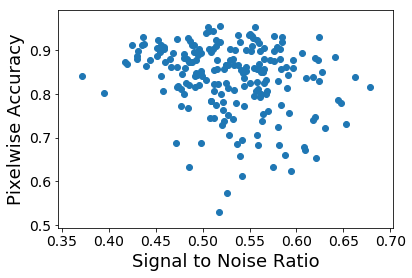

In [367]:
# plt.figure(figsize=(12,10))
plt.scatter(FePt_sbr,acc_list)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Noise Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)
# plt.savefig('FePt_SNR.png')

(array([0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 1. , 1.1, 1.2]),
 <a list of 9 Text xticklabel objects>)

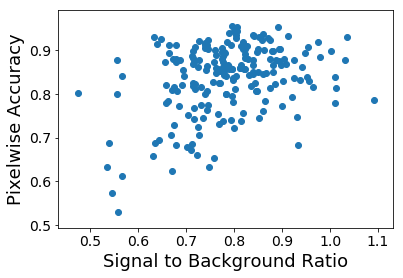

In [386]:
plt.scatter(FePt_sbr2,acc_list_fept)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

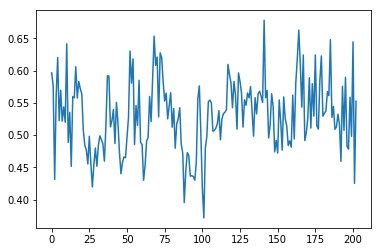

In [343]:
plt.plot(FePt_sbr)

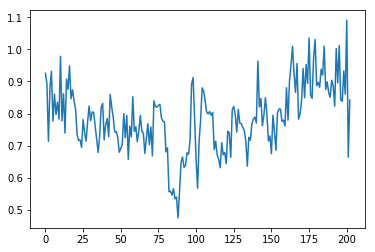

In [375]:
plt.plot(FePt_sbr2)

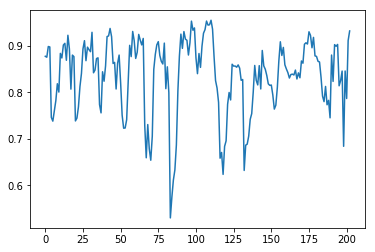

In [387]:
plt.plot(acc_list_fept)

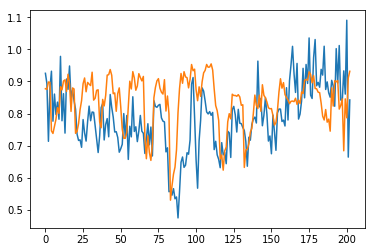

In [392]:
plt.plot(FePt_sbr2)
plt.plot(acc_list_fept)
# plt.xlim([100,200])

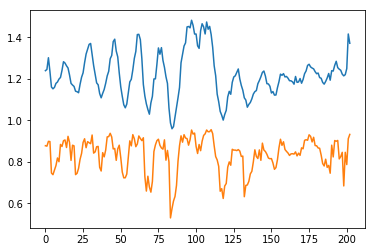

In [422]:
plt.plot(FePt_sbr3[:,0])
plt.plot(acc_list_fept)

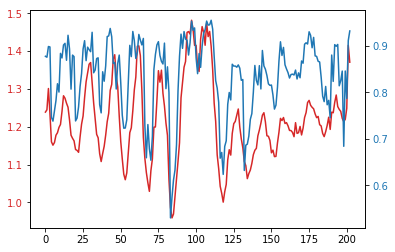

In [429]:
fig, ax1 = plt.subplots()

color = 'tab:red'
# ax1.set_xlabel('time (s)')
# ax1.set_ylabel('exp', color=color)
ax1.plot(FePt_sbr3[:,0], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
# ax2.set_ylabel('sin', color=color)  # we already handled the x-label with ax1
ax2.plot(acc_list_fept, color=color)
ax2.tick_params(axis='y', labelcolor=color)
# ax2.set_ylim([0.6,1])

(array([0.9, 1. , 1.1, 1.2, 1.3, 1.4, 1.5, 1.6]),
 <a list of 8 Text xticklabel objects>)

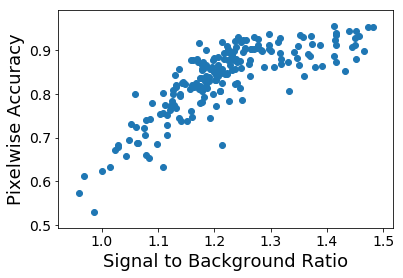

In [431]:
plt.scatter(FePt_sbr3[:,0],acc_list_fept)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

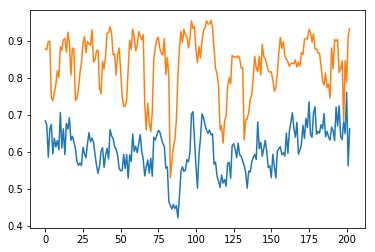

In [444]:
plt.plot(FePt_sbr4)
plt.plot(acc_list_fept)

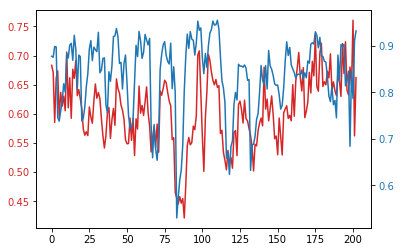

In [446]:
fig, ax1 = plt.subplots()

color = 'tab:red'
# ax1.set_xlabel('time (s)')
# ax1.set_ylabel('exp', color=color)
ax1.plot(FePt_sbr4, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
# ax2.set_ylabel('sin', color=color)  # we already handled the x-label with ax1
ax2.plot(acc_list_fept, color=color)
ax2.tick_params(axis='y', labelcolor=color)
# ax2.set_ylim([0.6,1])

(array([0.35, 0.4 , 0.45, 0.5 , 0.55, 0.6 , 0.65, 0.7 , 0.75, 0.8 ]),
 <a list of 10 Text xticklabel objects>)

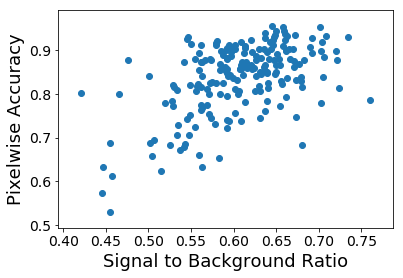

In [447]:
plt.scatter(FePt_sbr4,acc_list_fept)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

In [452]:
from scipy.stats import pearsonr
from scipy.stats import linregress

In [453]:
linregress(FePt_sbr4,acc_list_fept)

LinregressResult(slope=0.7234440778180238, intercept=0.39769987618846414, rvalue=0.5385205891209643, pvalue=1.160650787421063e-16, stderr=0.07984219095004579)

In [451]:
pearsonr(FePt_sbr4,acc_list_fept)

(0.5385205891209643, 1.1606507874210592e-16)

In [454]:
linregress(Au_sbr4,acc_list_Au)

LinregressResult(slope=-0.09661305890948738, intercept=0.9517791791037373, rvalue=-0.4207188461554747, pvalue=1.1242800558951694e-10, stderr=0.014240844682331482)

In [456]:
linregress(CdSe_sbr4,acc_list_cdse)

LinregressResult(slope=-0.40240794133113406, intercept=0.9699675041554181, rvalue=-0.8184632708910515, pvalue=9.093069098368949e-43, stderr=0.021665933560159077)

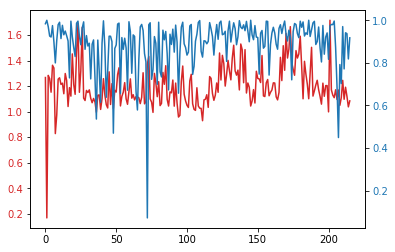

In [428]:
fig, ax1 = plt.subplots()

color = 'tab:red'
# ax1.set_xlabel('time (s)')
# ax1.set_ylabel('exp', color=color)
ax1.plot(Au_sbr3[:,0], color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
# ax2.set_ylabel('sin', color=color)  # we already handled the x-label with ax1
ax2.plot(acc_list_Au, color=color)
ax2.tick_params(axis='y', labelcolor=color)
# ax2.set_ylim([0.6,1])

In [357]:
FePt_sbr.std()

0.05480957639432416

In [380]:
FePt_sbr2.std()

0.10395216116359697

(0.6, 1)

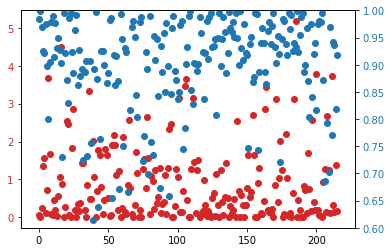

In [404]:
fig, ax1 = plt.subplots()

color = 'tab:red'
# ax1.set_xlabel('time (s)')
# ax1.set_ylabel('exp', color=color)
ax1.scatter(np.arange(0,len(Au_sbr2)),Au_sbr, color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis

color = 'tab:blue'
# ax2.set_ylabel('sin', color=color)  # we already handled the x-label with ax1
ax2.scatter(np.arange(0,len(Au_sbr2)),acc_list_Au, color=color)
ax2.tick_params(axis='y', labelcolor=color)
ax2.set_ylim([0.6,1])

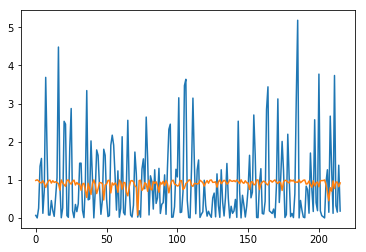

In [423]:

plt.plot(Au_sbr)
plt.plot(acc_list_Au)

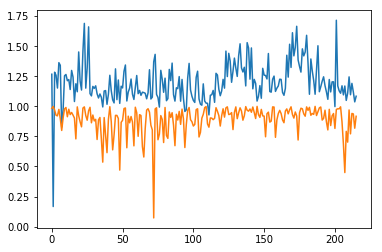

In [425]:
plt.plot(Au_sbr3[:,0])
plt.plot(acc_list_Au)

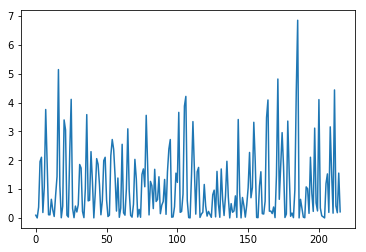

In [376]:
plt.plot(Au_sbr2)

(array([-1.,  0.,  1.,  2.,  3.,  4.,  5.,  6.,  7.,  8.]),
 <a list of 10 Text xticklabel objects>)

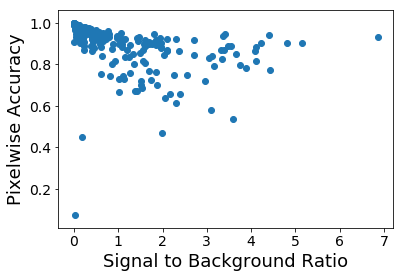

In [385]:
plt.scatter(Au_sbr2,acc_list_Au)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

(array([0. , 0.2, 0.4, 0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8, 2. ]),
 <a list of 11 Text xticklabel objects>)

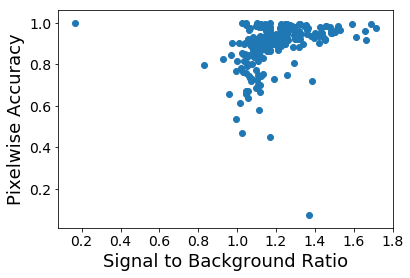

In [432]:
plt.scatter(Au_sbr3[:,0],acc_list_Au)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

(array([-0.5,  0. ,  0.5,  1. ,  1.5,  2. ,  2.5]),
 <a list of 7 Text xticklabel objects>)

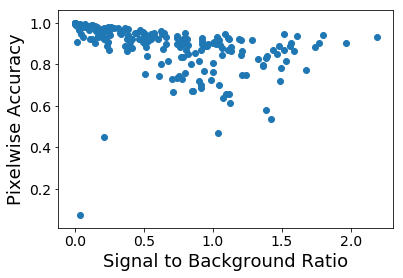

In [448]:
plt.scatter(Au_sbr4,acc_list_Au)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

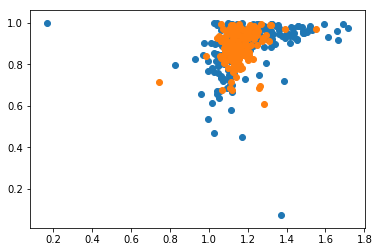

In [477]:
plt.scatter(Au_sbr3[:,0],acc_list_Au)
plt.scatter(CdSe_sbr3[:,0],acc_list_cdse)

In [358]:
Au_sbr.std()

1.017224110666252

In [379]:
Au_sbr2.std()

1.241370809121641

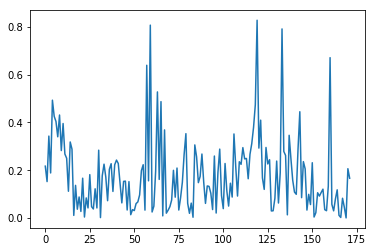

In [346]:
plt.plot(CdSe_sbr)

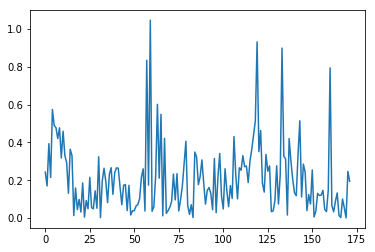

In [377]:
plt.plot(CdSe_sbr2)

(array([-0.2,  0. ,  0.2,  0.4,  0.6,  0.8,  1. ,  1.2]),
 <a list of 8 Text xticklabel objects>)

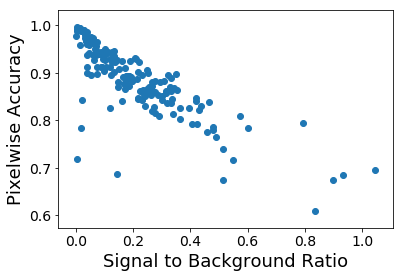

In [384]:
plt.scatter(CdSe_sbr2,acc_list_cdse)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

(array([0.6, 0.8, 1. , 1.2, 1.4, 1.6, 1.8]),
 <a list of 7 Text xticklabel objects>)

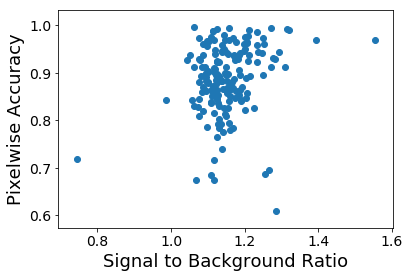

In [433]:
plt.scatter(CdSe_sbr3[:,0],acc_list_cdse)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

(array([-0.1,  0. ,  0.1,  0.2,  0.3,  0.4,  0.5,  0.6,  0.7,  0.8,  0.9]),
 <a list of 11 Text xticklabel objects>)

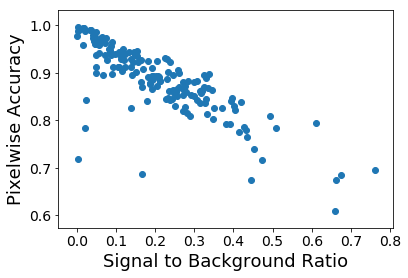

In [449]:
plt.scatter(CdSe_sbr4,acc_list_cdse)
plt.ylabel('Pixelwise Accuracy', fontsize = 18)
plt.xlabel('Signal to Background Ratio', fontsize = 18)
plt.yticks(fontsize=14)
plt.xticks(fontsize=14)

In [359]:
CdSe_sbr.std()

0.15543750539526394

In [378]:
CdSe_sbr2.std()

0.18310728467276247

In [361]:
acc_list_Au = np.asarray(acc_list_Au)

In [362]:
acc_list_cdse = np.asarray(acc_list_cdse)

In [363]:
acc_list_fept = np.asarray(FePt_acc_list)

In [364]:
acc_list_Au.std()


0.11535705570366694

In [365]:
acc_list_cdse.std()

0.0725068174735833

In [366]:
acc_list_fept.std()

0.07975724615826713

In [348]:
np.where(CdSe_sbr ==CdSe_sbr.max())

(array([119]),)

In [349]:
CdSe_sbr.max()

0.8276884193710022

In [350]:
CdSe_sbr[119]

0.8276884193710022

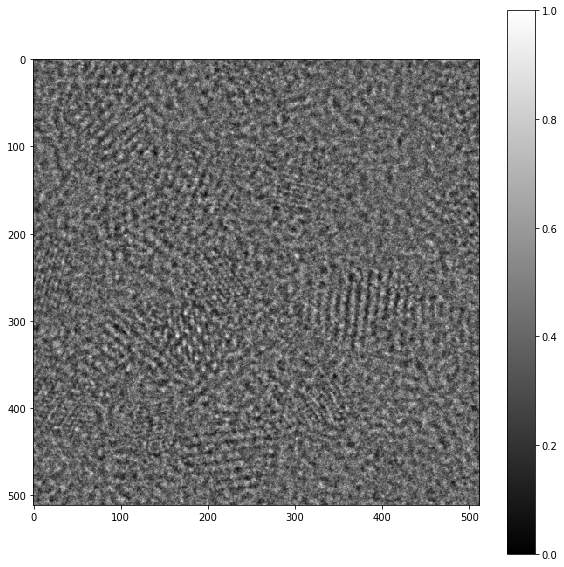

In [351]:
rdp.imm(CdSe[119])

In [352]:
acc_list_cdse[119]

0.6853904724121094

In [92]:
snrs_Au = SNR_stack(Au)

10/216 images done
20/216 images done
30/216 images done
40/216 images done
50/216 images done
60/216 images done
70/216 images done
80/216 images done
90/216 images done
100/216 images done
110/216 images done
120/216 images done
130/216 images done
140/216 images done
150/216 images done
160/216 images done
170/216 images done
180/216 images done
190/216 images done
200/216 images done
210/216 images done
Average SNR is   177.83
Median SNR is   174.66


In [93]:
Au_pred_all = model04.predict(Au)

In [94]:
Au_bin_all = sega.binarize_map(Au_pred_all[:,:,:,1],thresh)

In [95]:
au_maps = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/Au/Bal_unFilt_cutimages_20190423_maps.h5')['maps'][:,:,:,:]

In [96]:
acc_list_Au = []
for idx,m in enumerate(au_maps[:,:,:,1]):
    acc_list_Au.append(metrics.accuracy_score(m.flatten(),Au_bin_all[idx].flatten()))

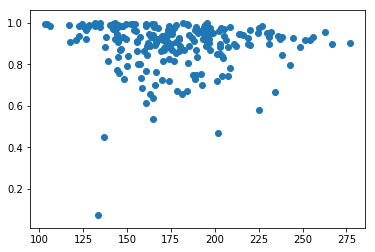

In [98]:
plt.scatter(snrs_Au,acc_list_Au)

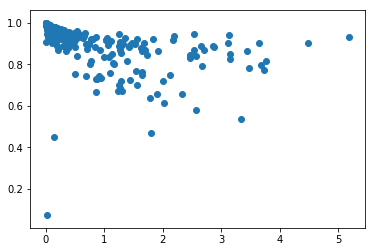

In [341]:
plt.scatter(Au_sbr,acc_list_Au)

In [99]:
cdse_maps = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/relabel_CdSedots/Bal_unFilt_CdSeRelabel512Images_20190724_maps.h5')['maps'][:,:,:,:]

In [100]:
cdse_pred_all = model04.predict(CdSe)

In [101]:
cdse_bin_all = sega.binarize_map(cdse_pred_all[:,:,:,1],thresh)

In [102]:
snrs_cdse = SNR_stack(CdSe)

10/172 images done
20/172 images done
30/172 images done
40/172 images done
50/172 images done
60/172 images done
70/172 images done
80/172 images done
90/172 images done
100/172 images done
110/172 images done
120/172 images done
130/172 images done
140/172 images done
150/172 images done
160/172 images done
170/172 images done
Average SNR is    31.67
Median SNR is    27.01


In [103]:
acc_list_cdse = []
for idx,m in enumerate(cdse_maps[:,:,:,1]):
    acc_list_cdse.append(metrics.accuracy_score(m.flatten(),cdse_bin_all[idx].flatten()))

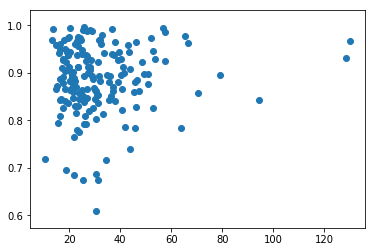

In [104]:
plt.scatter(snrs_cdse,acc_list_cdse)

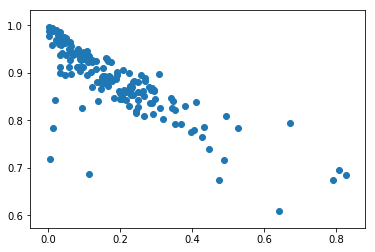

In [342]:
plt.scatter(CdSe_sbr,acc_list_cdse)

In [105]:
snr_all = np.concatenate((snrs,snrs_Au,snrs_cdse))

In [106]:
acc_all = np.concatenate((acc_list,acc_list_Au,acc_list_cdse))

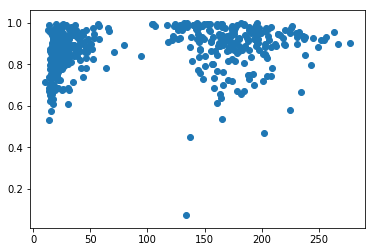

In [107]:
plt.scatter(snr_all,acc_all)

In [111]:
fpr,tpr, t = metrics.roc_curve(fept_maps[:,:,:,1].flatten(),fept_pred[:,:,:,1].flatten())

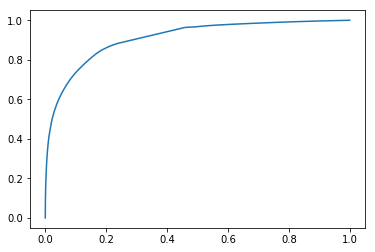

In [112]:
plt.plot(fpr,tpr)

## CdSe Rods

In [131]:
cdse_rods = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/CdSe_rods/20190527CdSe_cutimages512_20190606.h5')['images'][:,:,:,:]

In [132]:
cdse_rods = rdp.median_filter_stack(cdse_rods)

In [133]:
pred_cdse_rods = model04.predict(cdse_rods)

In [145]:
cdse_rods.shape

(36, 512, 512, 1)

137.43439022475675


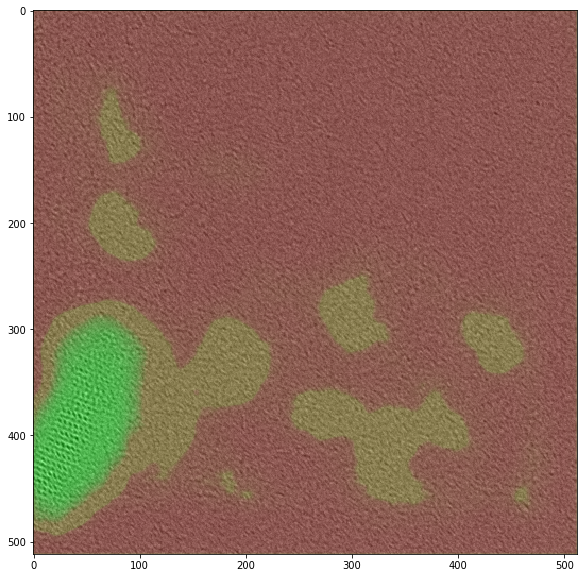

In [178]:
idx = 35
rdp.immOverlay(cdse_rods,pred_cdse_rods[:,:,:,:],idx)
print(snr_cdserods[idx])

In [146]:
snr_cdserods = SNR_stack(cdse_rods) 

10/36 images done
20/36 images done
30/36 images done
Average SNR is    87.60
Median SNR is    48.95


In [134]:
aucdse = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/combined_stacks/Bal_MedFilt_AuCdSeDots_20190726.h5')['images'][:,:,:,:]

In [135]:
aucdse_maps = h5py.File('/Users/cgroschner/Documents/HTTEM/particle_data/combined_stacks/Bal_MedFilt_AuCdSeDots_20190726_maps.h5')['maps'][:,:,:,:]

## Au Focal Series

In [179]:
aufocal = h5py.File('/Users/cgroschner/Desktop/20190826/'+'20190826_AuFocalSeries1_512cutimages.h5','r')['images'][:,:,:,:]
aufocal_maps = h5py.File('/Users/cgroschner/Desktop/20190826/'+'20190826_AuFocalSeries1_512cutmaps.h5','r')['maps'][:,:,:,:]

In [185]:
aufocal.shape

(23, 512, 512, 1)

In [186]:
aufocal_maps.shape

(22, 512, 512, 2)

In [180]:
aufocal = rdp.median_filter_stack(aufocal)

In [181]:
pred_aufocal = model04.predict(aufocal)

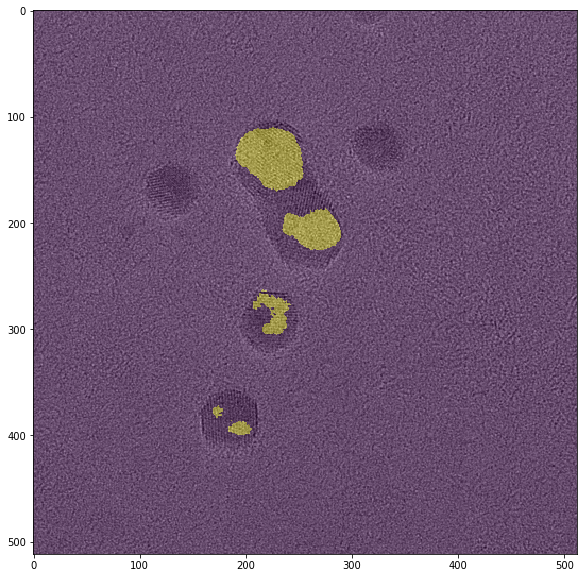

In [247]:
rdp.immOverlay(aufocal,bin_aufocal,0)

In [188]:
acc, thresh = sega.find_thresh(aufocal_maps,pred_aufocal[:22])

threshold going up
0.4911937713623047 0.75
0.5332078066739169 0.8
0.5828652815385298 0.8500000000000001
0.6390205730091442 0.9000000000000001
0.7098641829057173 0.9500000000000002


In [198]:
bin_aufocal = sega.binarize_map(pred_aufocal[:,:,:,1],0.64)

In [199]:
metrics.accuracy_score(aufocal_maps[:,:,:,1].flatten(),bin_aufocal[:22].flatten())

0.424056660045277

In [200]:
acc_list_aufs = []
for idx,m in enumerate(aufocal_maps[:,:,:,1]):
    acc_list_aufs.append(metrics.accuracy_score(m.flatten(),bin_aufocal[idx].flatten()))

In [207]:
acc_list_aufs = np.array(acc_list_aufs)

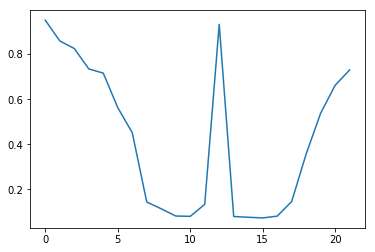

In [208]:
plt.plot(acc_list_aufs)

In [202]:
snr_aufs = SNR_stack(aufocal)

10/23 images done
20/23 images done
Average SNR is    26.42
Median SNR is    18.16


(0, 50)

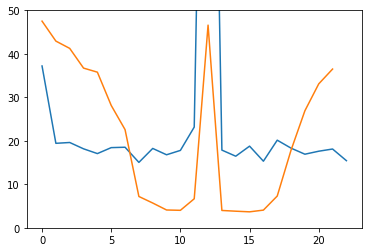

In [211]:
plt.plot(snr_aufs)
plt.plot(acc_list_aufs*50)
plt.ylim([0,50])

# Kernel Plots

In [116]:
def generate_pattern(model,layer_name, filter_index, size=150):
    layer_output = model.get_layer(layer_name).output
    loss = K.mean(layer_output[:, :, :, filter_index])
    grads = K.gradients(loss, model.input)[0]
    grads /= (K.sqrt(K.mean(K.square(grads))) + 1e-5)
    iterate = K.function([model.input], [loss, grads])
    input_img_data = np.random.random((1, size, size, 1)) * 20 + 128
    input_img_data = input_img_data/input_img_data.max()
    step = 1
    for i in range(40):
        loss_value, grads_value = iterate([input_img_data])
        input_img_data += grads_value * step
    return input_img_data

In [114]:
model04.summary()

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_1 (InputLayer)            (None, 512, 512, 1)  0                                            
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 512, 512, 4)  40          input_1[0][0]                    
__________________________________________________________________________________________________
batch_normalization_1 (BatchNor (None, 512, 512, 4)  16          conv2d_1[0][0]                   
__________________________________________________________________________________________________
max_pooling2d_1 (MaxPooling2D)  (None, 256, 256, 4)  0           batch_normalization_1[0][0]      
__________________________________________________________________________________________________
conv2d_2 (

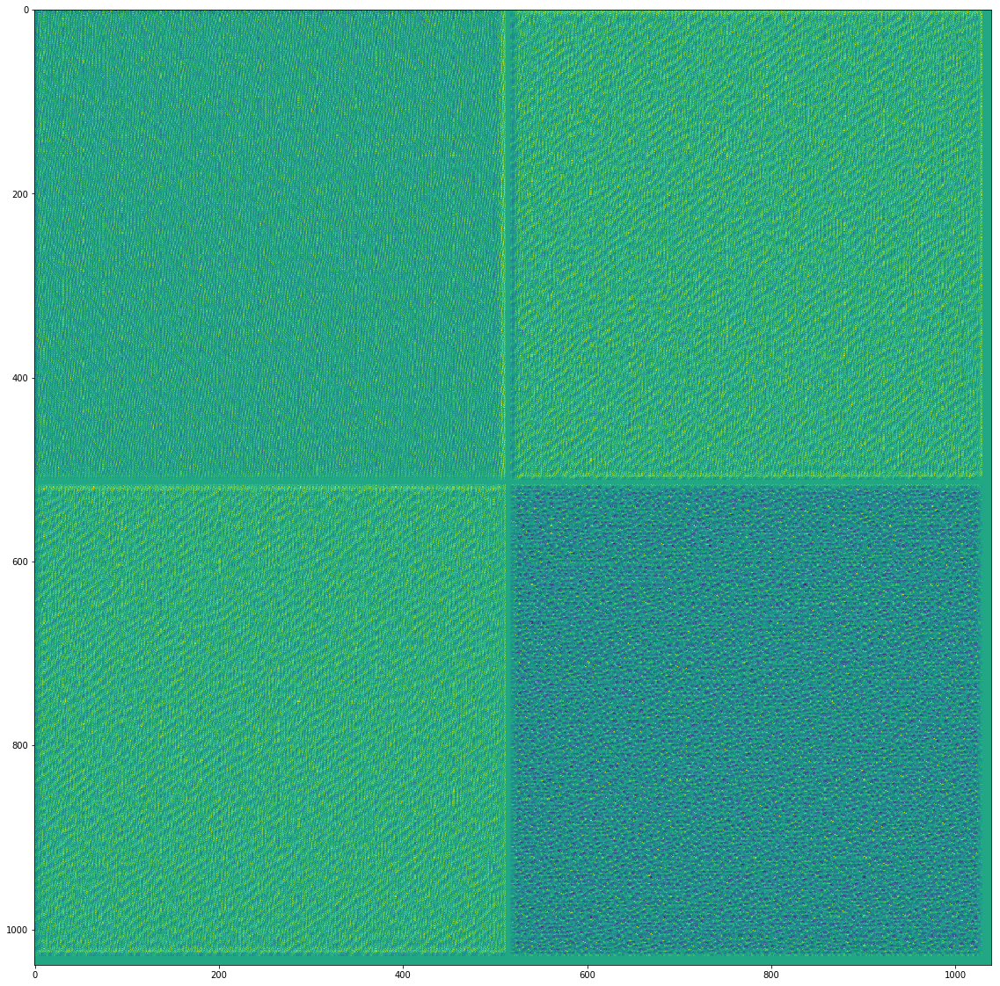

In [130]:
layer_name = 'conv2d_3'
size = 512
margin = 5
results = np.zeros((2 * size + 3 * margin, 2 * size + 3 * margin))
for i in range(2):
    for j in range(2):
        filter_img = generate_pattern(model04,layer_name, i + (j) , size=size)
        horizontal_start = i * size + i * margin
        horizontal_end = horizontal_start + size
        vertical_start = j * size + j * margin
        vertical_end = vertical_start + size
        results[horizontal_start: horizontal_end,vertical_start: vertical_end] = filter_img.reshape(512,512)/filter_img.max()
plt.figure(figsize=(20, 20))
plt.imshow(results)

In [472]:
layer_name = 'conv2d_10'
size = 512
margin = 5
results = np.zeros((2 * size + 3 * margin, 2 * size + 3 * margin))
for i in range(2):
    for j in range(2):
        filter_img = generate_pattern(model04,layer_name, i + (j) , size=size)
        horizontal_start = i * size + i * margin
        horizontal_end = horizontal_start + size
        vertical_start = j * size + j * margin
        vertical_end = vertical_start + size
        results[horizontal_start: horizontal_end,vertical_start: vertical_end] = filter_img.reshape(512,512)/filter_img.max()
plt.figure(figsize=(10, 10))
plt.axis('off')
plt.imshow(results, cmap = 'magma')
# plt.savefig('model04_conv10_kernels.png')

TypeError: ufunc 'isfinite' not supported for the input types, and the inputs could not be safely coerced to any supported types according to the casting rule ''safe''

<Figure size 720x720 with 0 Axes>

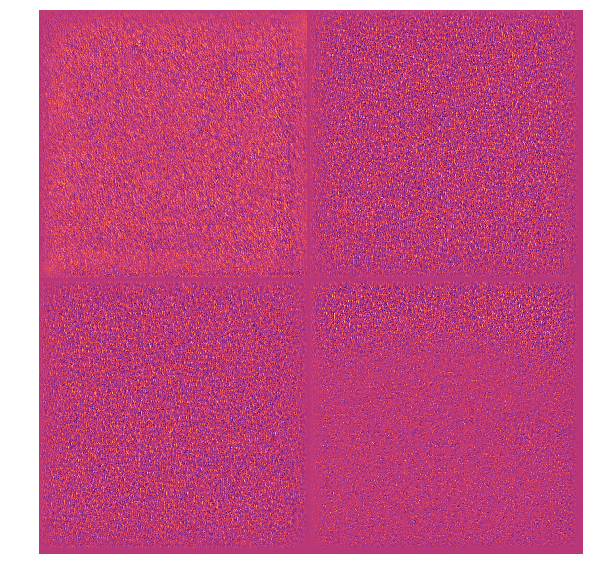

In [475]:
plt.figure(figsize=(10,10))
plt.axis('off')
plt.imshow(results,cmap='magma')

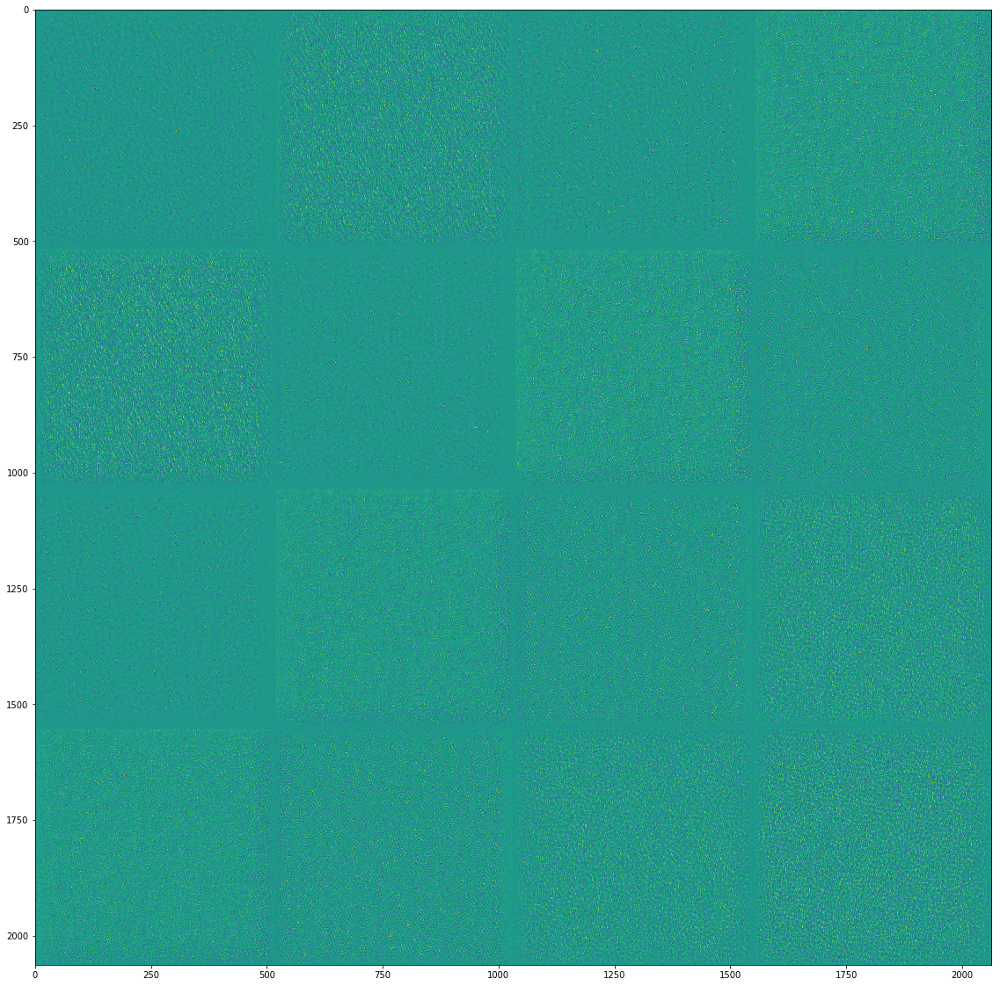

In [464]:
layer_name = 'conv2d_6'
size = 512
margin = 5
results = np.zeros((4 * size + 3 * margin, 4 * size + 3 * margin))
for i in range(4):
    for j in range(4):
        filter_img = generate_pattern(model04,layer_name, i + (j) , size=size)
        horizontal_start = i * size + i * margin
        horizontal_end = horizontal_start + size
        vertical_start = j * size + j * margin
        vertical_end = vertical_start + size
        results[horizontal_start: horizontal_end,vertical_start: vertical_end] = filter_img.reshape(512,512)/filter_img.max()
plt.figure(figsize=(20, 20))
plt.imshow(results)
plt.savefig('model04_conv6_kernels.png')

/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/axes/_base.py:3443: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=-0.5, top=-0.5
  'bottom=%s, top=%s') % (bottom, top))
/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/axis.py:1086: UserWarning: Unable to find pixel distance along axis for interval padding of ticks; assuming no interval padding needed.
  warnings.warn("Unable to find pixel distance along axis "
/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/axis.py:1096: UserWarni

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

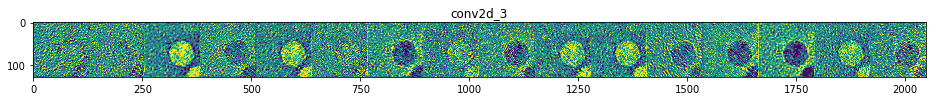

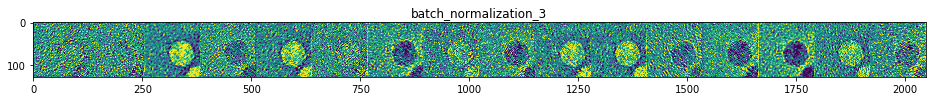

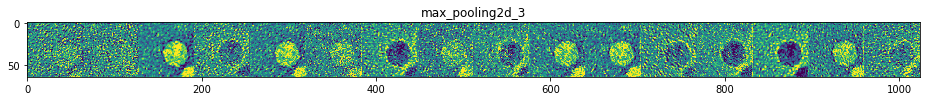

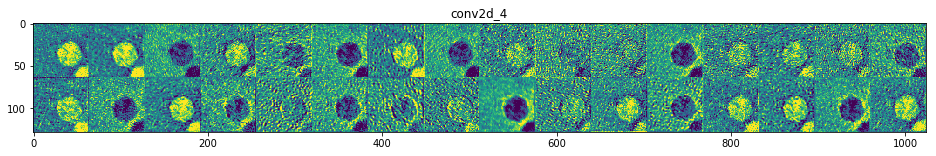

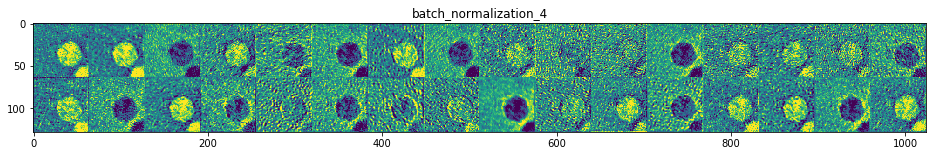

...

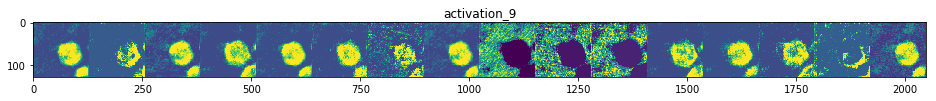

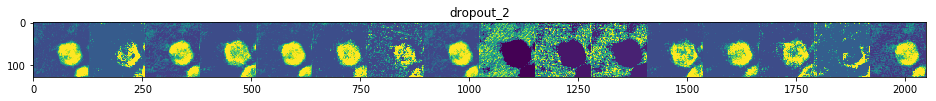

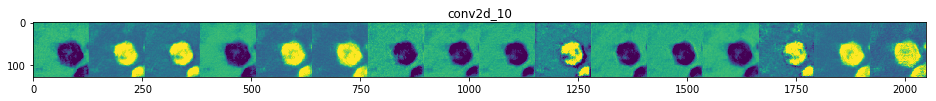

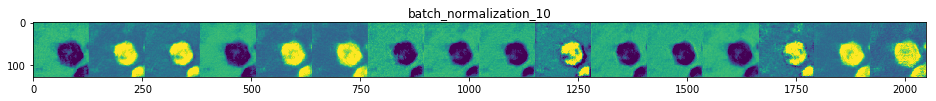

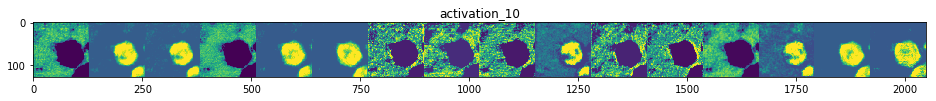

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

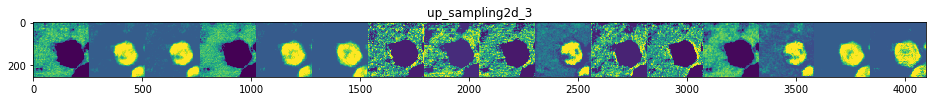

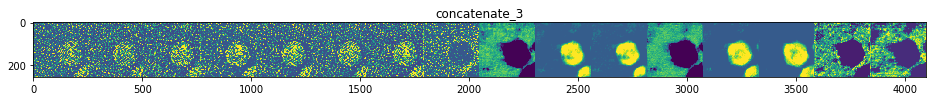

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

In [127]:
cviz.feat_grid(model04,Au[2:3,:,:,:],86)

/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/axes/_base.py:3443: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=-0.5, top=-0.5
  'bottom=%s, top=%s') % (bottom, top))
/Users/cgroschner/Documents/HTTEM/segmentation/CNNviz.py:33: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std()
/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/axis.py:1086: UserWarning: Unable to find pixel distance along axis for interval padding of ticks; assuming no interval padding 

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

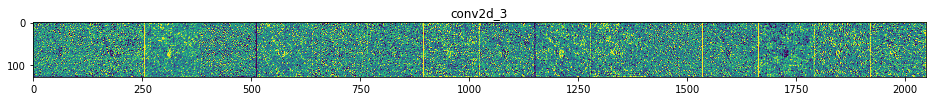

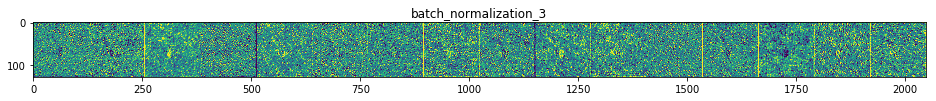

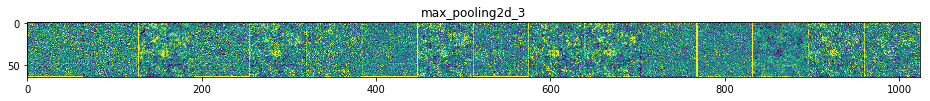

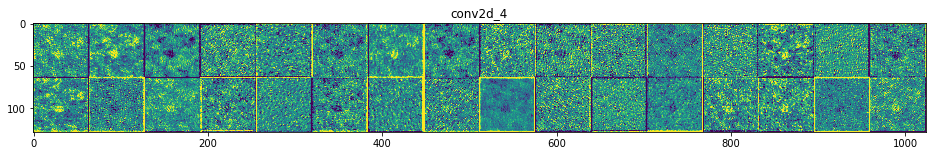

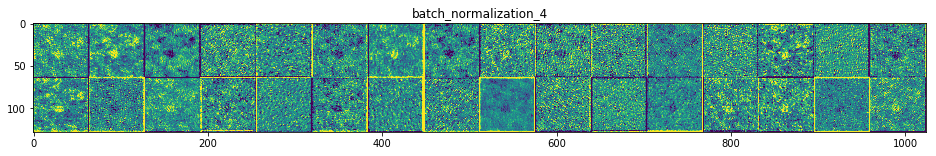

...

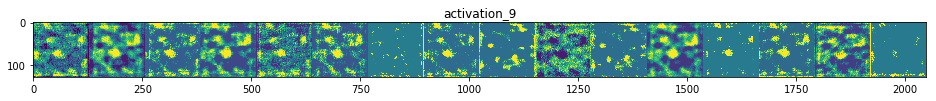

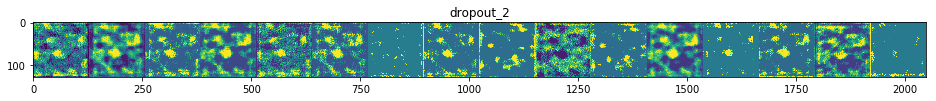

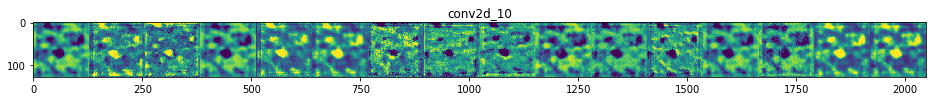

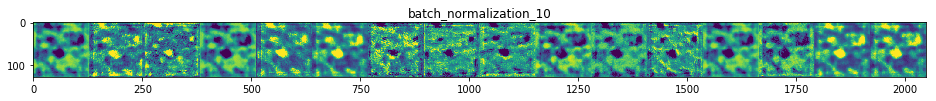

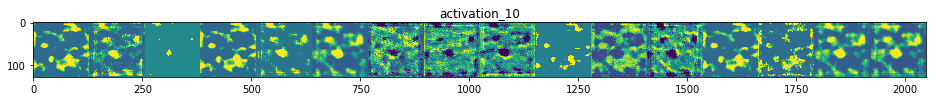

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

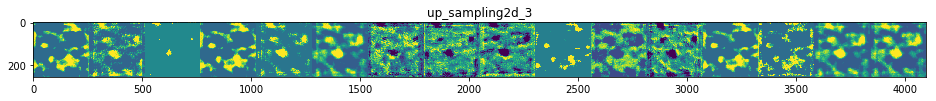

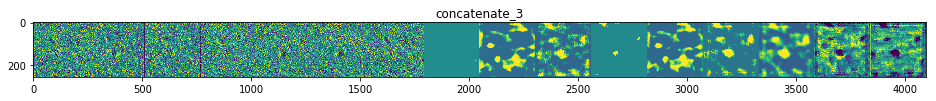

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

In [128]:
cviz.feat_grid(model04,CdSe[2:3,:,:,:],86)

/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/axes/_base.py:3443: UserWarning: Attempting to set identical bottom==top results
in singular transformations; automatically expanding.
bottom=-0.5, top=-0.5
  'bottom=%s, top=%s') % (bottom, top))
/Users/cgroschner/Documents/HTTEM/segmentation/CNNviz.py:33: RuntimeWarning: invalid value encountered in true_divide
  channel_image /= channel_image.std()
/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)
/Users/cgroschner/anaconda/lib/python3.6/site-packages/matplotlib/axis.py:1086: UserWarning: Unable to find pixel distance along axis for interval padding of ticks; assuming no interval padding 

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

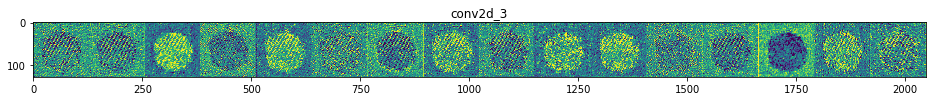

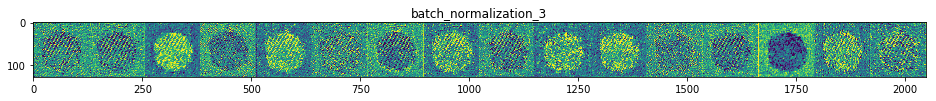

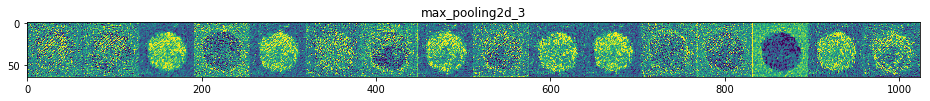

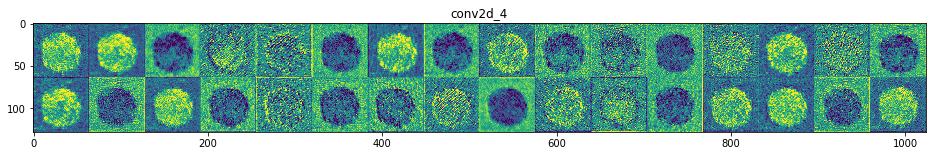

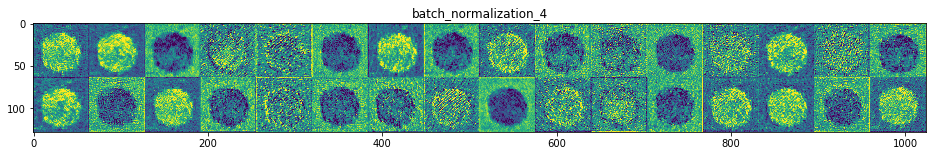

...

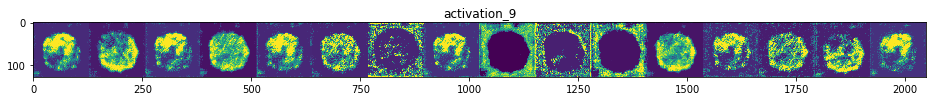

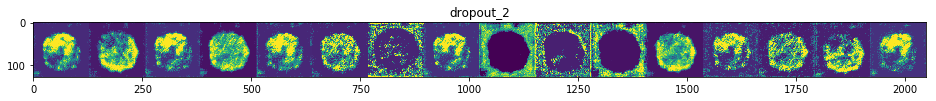

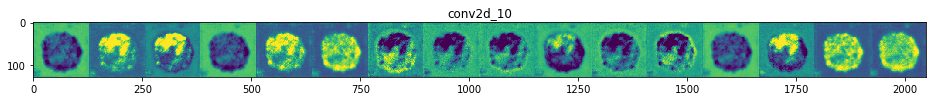

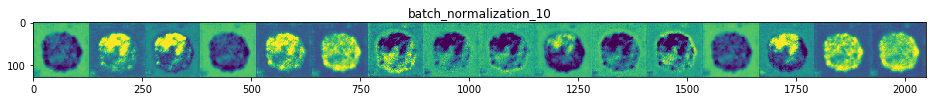

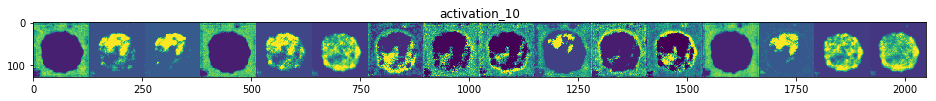

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

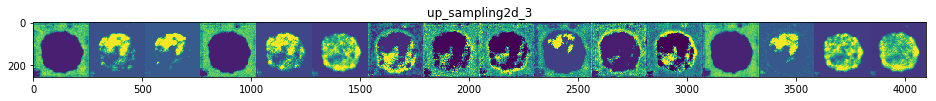

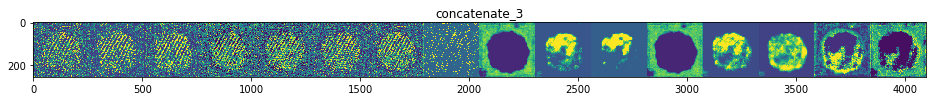

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

RuntimeError: libpng signaled error

<Figure size 1152x0 with 1 Axes>

In [129]:
cviz.feat_grid(model04,FePt[105:106,:,:,:],86)